In [1]:
import trimesh

mesh = trimesh.load_mesh('../data/stl/EA-HV_electrode.STL')

In [2]:
mesh = mesh.subdivide_to_size(1)

In [15]:
areas = mesh.area_faces.tolist()
centroids = mesh.triangles_center.tolist()

In [16]:
from sklearn.cluster import KMeans, BisectingKMeans

kmeans = BisectingKMeans(n_clusters=1000)
clusters = kmeans.fit_predict(centroids, sample_weight=areas)

Text(0, 0.5, 'Number of triangles')

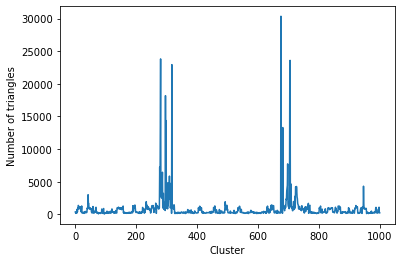

In [17]:
import numpy as np
import matplotlib.pyplot as plt
plt.plot(np.unique(clusters, return_counts=True)[1])
plt.xlabel('Cluster')
plt.ylabel('Number of triangles')

In [21]:
import numpy as np
from tqdm import trange

tot_mesh = None
areas = []
for cluster in trange(kmeans.n_clusters):
    submesh = mesh.submesh([np.where(clusters == cluster)[0]], append=True)
    submesh.visual.face_colors = trimesh.visual.random_color()
    areas.append(submesh.area_faces.sum())
    
    # simplify mesh
    submesh.export(f'../data/stl/electrode_stls/1000_parts/cluster_{cluster}.stl')

    if tot_mesh is None:
        tot_mesh = submesh
    else:
        tot_mesh = tot_mesh + submesh
    

100%|██████████| 1000/1000 [01:28<00:00, 11.32it/s]


(array([  4.,   0.,   2.,   1.,   1.,   4.,   4.,   4.,   9.,  21.,  38.,
         89., 115., 104.,  80.,  64.,  52.,  54.,  55.,  47.,  49.,  40.,
         56.,  46.,  25.,  11.,   2.,   2.,   4.,   3.,   3.,   2.,   2.,
          1.,   0.,   2.,   0.,   1.,   0.,   0.,   0.,   1.,   0.,   0.,
          1.,   0.,   0.,   0.,   0.,   1.]),
 array([ 4.86035389,  6.59199689,  8.32363988, 10.05528288, 11.78692588,
        13.51856887, 15.25021187, 16.98185487, 18.71349786, 20.44514086,
        22.17678386, 23.90842685, 25.64006985, 27.37171285, 29.10335584,
        30.83499884, 32.56664184, 34.29828483, 36.02992783, 37.76157083,
        39.49321382, 41.22485682, 42.95649982, 44.68814281, 46.41978581,
        48.15142881, 49.8830718 , 51.6147148 , 53.3463578 , 55.07800079,
        56.80964379, 58.54128679, 60.27292978, 62.00457278, 63.73621578,
        65.46785877, 67.19950177, 68.93114477, 70.66278776, 72.39443076,
        74.12607376, 75.85771675, 77.58935975, 79.32100275, 81.05264574,
 

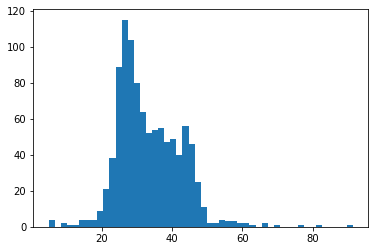

In [19]:
plt.hist(areas, bins=50)

In [20]:
tot_mesh.show()

In [12]:
stl1 = trimesh.load_mesh('../data/stl/EA-HV_fiber.STL')
stl2 = trimesh.load_mesh('../data/stl/EA-HV_no_electrode.STL')